# One-Dimensional Climate Models: The Basics of Brown Dwarfs

In this tutorial you will learn the very basics of running 1D climate runs. For a more in depth look at the climate code check out [Mukherjee et al. 2022](https://arxiv.org/abs/2208.07836) (note this should also be cited if using this code/tutorial). 

What you should already be familiar with: 

- [basics of running/analyzing thermal spectra](https://natashabatalha.github.io/picaso/tutorials.html#basics-of-thermal-emission)
- [how to analyze thermal emission spectra](https://natashabatalha.github.io/picaso/notebooks/workshops/ERS2021/ThermalEmissionTutorial.html)

What you will need to download to use this tutorial: 

1. [Download](https://zenodo.org/record/5590989#.Yzy2YOzMI8a) 1460 PT, 196 wno Correlated-K Tables from Roxana Lupu to be used by the climate code for opacity 
2. [Download](https://zenodo.org/record/5063476/files/structures_m%2B0.0.tar.gz?download=1) the sonora bobcat cloud free `structures_` file so that you can validate your model run 

**Note**: the two files above are dependent on metallicity and C/O. For this tutorial we will stick to solar M/H and solar C/O, but note that you can change that by picking the right C-K file in the `opannection` step

In [1]:
import warnings
warnings.filterwarnings('ignore')
import picaso.justdoit as jdi
import picaso.justplotit as jpi
jpi.output_notebook()
import astropy.units as u
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

Loading BokehJS ...

In [2]:
#1 ck tables from roxana
mh = '+000' #log metallicity
CtoO = '100'# CtoO ratio relative to solar

ck_db = f'/data/kcoeff_2020_v3/sonora_2020_feh{mh}_co_{CtoO}.data.196'
#sonora bobcat cloud free structures file
sonora_profile_db = '/data/sonora_bobcat/structure/structures_m+0.0'


## What does a climate model solve for?

1D Radiative-Convective Equilibrium Models solve for atmospheric structures of brown dwarfs and exoplanets, which includes:

1\. The Temperature Structure (T(P) profile)
 
2\. The Chemical Structure 

3\. Energy Transport in the atmosphere

But these physical components are not independent of each other. For example, the chemistry is dependent on the T(P) profile, the radiative transfer is dependent on clouds and the chemistry and so on. 

`PICASO` tries to find the atmospheric state of your object by taking care of all of these processes and their interconnections self-consistently and iteratively. Therefore, you will find that the climate portion of `PICASO` is slower than running a single forward model evaluation. 

## Starting up the Run

You will notice that starting a run is nearly identical as running a spectrum. However, how we will add `climate=True` to our inputs flag. We will also specify `browndwarf` in this case, which will turn off the irradiation the object is receiving. 

New Parameter: **Effective Temperature**. This excerpt from [Modeling Exoplanetary Atmospheres (Fortney et al)](https://arxiv.org/pdf/1804.08149.pdf) provides a thorough description and more reading, if you are interested.

>If the effective temperature, $T_{eff}$, is defined as the temperature of a blackbody of
the same radius that would emit the equivalent flux as the real planet, $T_{eff}$ and $T_{eq}$
can be simply related. This relation requires the inclusion of a third temperature,
$T_{int}$, the intrinsic effective temperature, that describes the flux from the planet’s
interior. These temperatures are related by:"

>$T_{eff}^4 =  T_{int}^4 + T_{eq}^4$

>We then recover our limiting cases: if a planet is self-luminous (like a young giant
planet) and far from its parent star, $T_{eff} \approx  T_{int}$; for most rocky planets, or any
planets under extreme stellar irradiation, $T_{eff} \approx T_{eq}$.

In [3]:
cl_run = jdi.inputs(calculation="browndwarf", climate = True) # start a calculation 

#note you need to put the climate keyword to be True in order to do so
# now you need to add these parameters to your calculation  


teff= 1000 # Effective Temperature of your Brown Dwarf in K
grav = 1000 # Gravity of your brown dwarf in m/s/s

cl_run.gravity(gravity=grav, gravity_unit=u.Unit('m/(s**2)')) # input gravity
cl_run.effective_temp(teff) # input effective temperature

Let's now grab our gaseous opacities, whose path we have already defined above. Again, this code uses a correlated-k approach for accurately capturing opacities (see [section 2.1.4; Mukerjee et al 2022](https://arxiv.org/pdf/2208.07836.pdf)).

In [4]:
# Notice The keyword ck is set to True because you want to use the correlated-k opacities for your calculation
# and not the line by line opacities
opacity_ck = jdi.opannection(ck_db=ck_db) # grab your opacities

## Initial T(P)  Guess

Every calculation requires an initial guess of the pressure temperature profile. The code will iterate from there to find the correct solution. A few tips: 

1. We recommend **using typically 51-91 atmospheric pressure levels**. Too many pressure layers increases the computational time required for convergence. Too little layers makes the atmospheric grid too coarse for an accurate calculation.

2. Start with **a guess that is close to your expected solution**. We will show an example using an isothermal P(T) profile below so you can see the iterative process. Later though, we recommend leveraging pre-computed grids (e.g. Sonora) as a starting guess for Brown Dwarfs. 


In [5]:
nlevel = 91 # number of plane-parallel levels in your code

#Lets set the max and min at 1e-4 bars and 500 bars

Pmin = 1e-4 #bars
Pmax = 500 #bars
pressure=np.logspace(np.log10(Pmin),np.log10(Pmax),nlevel) # set your pressure grid

temp_guess = np.zeros(shape=(nlevel)) + 500 # K , isothermal atmosphere guess

## Initial Convective Zone Guess

You also need to have a crude guess of the convective zone of your atmosphere. Generally the deeper atmosphere is always convective. Again a good guess is always the published SONORA grid of models for this. But lets assume that the bottom 7 levels of the atmosphere is convective. 

**New Parameters:**

1. `nofczns` : Number of convective zones. Though the code has functionality to solve for more than one. In this basic tutorial, let's stick to 1 for now.
2. `rfacv`: (See Mukherjee et al Eqn. 20 `r_st`) https://arxiv.org/pdf/2208.07836.pdf
3. `nstr_upper` : this defines the top most level of your guessed convective zone. If you don't have a clue where your convective zone might end be choose a number that is $\sim$nlevel-5 (a few pressure levels away from the very bottom of your grid)

Non-zero values of rst (aka "rfacv" legacy terminology) is only relevant when the external irradiation on the atmosphere is non-zero. In the scenario when a user is computing a planet-wide average T(P) profile, the stellar irradiation is contributing to 50% (one hemisphere) of the planet and as a result rst = 0.5. If instead the goal is to compute a night-side average atmospheric state, rst is set to be 0. On the other extreme, to compute the day-side atmospheric state of a tidally locked planet rst should be set at 1.

In [6]:
nofczns = 1 # number of convective zones initially. Let's not play with this for now.

nstr_upper = 83 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones

# Here are some other parameters needed for the code.
rfacv = 0.0 #we are focused on a brown dwarf so let's keep this as is

Now we would use the inputs_climate function to input everything together to our cl_run we started.

In [7]:
cl_run.inputs_climate(temp_guess= temp_guess, pressure= pressure, 
                      nstr = nstr, nofczns = nofczns , rfacv = rfacv)

## Run the Climate Code

 The actual climate code can be run with the cl_run.run command. The save_all_profiles is set to True to save the T(P) profile at all steps. The code will now iterate from your guess to reach the correct atmospheric solution for your brown dwarf of interest.
 
 

In [8]:
out = cl_run.climate(opacity_ck, save_all_profiles=True,with_spec=True)

Iteration number  0 , min , max temp  499.99441223740007 755.7256184267335 , flux balance  -0.9375713000957998
Iteration number  1 , min , max temp  499.684629541375 2408.2450611089544 , flux balance  0.12082246704840309


Iteration number  2 , min , max temp  489.0489855596098 2400.4827908767315 , flux balance  0.12943466540276088
Iteration number  3 , min , max temp  478.7144203837924 2393.3279356287444 , flux balance  0.12147972759228186
Iteration number  4 , min , max temp  457.22135487015066 2379.115692181715 , flux balance  0.10781988494806535
Iteration number  5 , min , max temp  364.0917364355565 2323.581628774084 , flux balance  0.09583341293536846
Iteration number  6 , min , max temp  305.6636424896158 2314.511883907575 , flux balance  0.008816341975061157
Iteration number  7 , min , max temp  275.65114238837873 2313.8549187701637 , flux balance  0.0002846276663427909
Iteration number  8 , min , max temp  266.6542309263717 2313.814702059855 , flux balance  1.060434512602519e-05
 We are already at a root, tolf , test =  5e-05 ,  1.060434512602519e-05
Big iteration is  266.6542309263717 0


Iteration number  0 , min , max temp  267.4805886558728 2353.263324195818 , flux balance  -0.8107827692691664
Iteration number  1 , min , max temp  277.0781216370256 2765.7119542549335 , flux balance  -0.7092698041663692
Iteration number  2 , min , max temp  290.63182267809293 3035.0476392696132 , flux balance  -0.5580046958917871


Iteration number  3 , min , max temp  344.5601059833999 3757.5067605696545 , flux balance  0.4130787669453553
Iteration number  4 , min , max temp  334.7488160906482 3573.3074886701215 , flux balance  0.05055089962015744
Iteration number  5 , min , max temp  333.5329910027303 3549.312440333875 , flux balance  0.0012940773383887767
Iteration number  6 , min , max temp  333.5015555175979 3548.91368724969 , flux balance  7.594977461031216e-06
In t_start: Converged Solution in iterations  6
Big iteration is  333.5015555175979 1


Iteration number  0 , min , max temp  333.6847625425446 3618.9398849662466 , flux balance  -0.181285220349651
Iteration number  1 , min , max temp  355.05342993876326 5199.9 , flux balance  0.01922278426944214
Iteration number  2 , min , max temp  353.3192578152149 5199.9 , flux balance  0.0003152873071917125
Iteration number  3 , min , max temp  353.2795104584925 5199.9 , flux balance  1.6756955098714269e-06
Iteration number  4 , min , max temp  353.278951817682 5199.9 , flux balance  8.69952105305755e-09
In t_start: Converged Solution in iterations  4
Big iteration is  353.278951817682 2


Iteration number  0 , min , max temp  353.38425552615655 5199.9 , flux balance  -0.02446863680275883
Iteration number  1 , min , max temp  357.8187283187612 5199.9 , flux balance  0.0006892507979793695
Iteration number  2 , min , max temp  357.7852138622747 5199.9 , flux balance  4.518773896925885e-06
Iteration number  3 , min , max temp  357.7852121869602 5199.9 , flux balance  4.504008245557094e-06
In t_start: Converged Solution in iterations  3
Big iteration is  357.7852121869602 3


Iteration number  0 , min , max temp  357.8003729029258 5199.9 , flux balance  -0.006183689922693025
In t_start: Converged Solution in iterations  0
Profile converged before itmx


Iteration number  0 , min , max temp  357.8152677932942 5199.9 , flux balance  -0.006100070665392575
In t_start: Converged Solution in iterations  0
Big iteration is  357.8152677932942 0


Iteration number  0 , min , max temp  357.8299029188794 5199.9 , flux balance  -0.006017698709388589
In t_start: Converged Solution in iterations  0
Profile converged before itmx
 convection zone status
0 83 89 0 0 0
1
[ 0 80 80 80 83 89]


Iteration number  0 , min , max temp  357.8454650213587 5199.9 , flux balance  -0.0059264054272434846
Iteration number  1 , min , max temp  358.5340630073482 5199.9 , flux balance  6.701353965856e-05
Iteration number  2 , min , max temp  358.54142846061393 5199.9 , flux balance  2.3440364618448767e-07
In t_start: Converged Solution in iterations  2
Big iteration is  358.54142846061393 0


Iteration number  0 , min , max temp  358.54189377982397 5199.9 , flux balance  -0.002219833404027642
In t_start: Converged Solution in iterations  0
Profile converged before itmx
Grow Phase : Upper Zone
[ 0 79 80 80 83 89]


Iteration number  0 , min , max temp  358.54472115685417 5199.9 , flux balance  -0.002167452681643466
Iteration number  1 , min , max temp  358.65417213253176 5199.9 , flux balance  1.0016017088360219e-05
Iteration number  2 , min , max temp  358.65567702694693 5199.9 , flux balance  1.711958756863136e-08
Iteration number  3 , min , max temp  358.6556989456957 5199.9 , flux balance  -9.33034498200691e-12
In t_start: Converged Solution in iterations  3
Big iteration is  358.6556989456957 0


Iteration number  0 , min , max temp  358.6558217280679 5199.9 , flux balance  -0.0008635275885169664
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 79 81 81 83 89]


Iteration number  0 , min , max temp  358.6567925129316 5199.9 , flux balance  -0.0008336097111106223
In t_start: Converged Solution in iterations  0
Big iteration is  358.6567925129316 0


Iteration number  0 , min , max temp  358.6577397084271 5199.9 , flux balance  -0.000816399861440016
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 78 81 81 83 89]


Iteration number  0 , min , max temp  358.65874749919675 5199.9 , flux balance  -0.0007966712951396764
In t_start: Converged Solution in iterations  0
Big iteration is  358.65874749919675 0


Iteration number  0 , min , max temp  358.6597471554962 5199.9 , flux balance  -0.0007781113604892664
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 77 81 81 83 89]


Iteration number  0 , min , max temp  358.6606365800866 5199.9 , flux balance  -0.0007630185956735683
In t_start: Converged Solution in iterations  0
Big iteration is  358.6606365800866 0


Iteration number  0 , min , max temp  358.66153416892786 5199.9 , flux balance  -0.000746050441041222
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 76 81 81 83 89]


Iteration number  0 , min , max temp  358.6622462228763 5199.9 , flux balance  -0.0007646395022767075
In t_start: Converged Solution in iterations  0
Big iteration is  358.6622462228763 0


Iteration number  0 , min , max temp  358.6629819663984 5199.9 , flux balance  -0.0007490583166722165
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 75 81 81 83 89]


Iteration number  0 , min , max temp  358.6654350916063 5199.9 , flux balance  -0.0031392259853150004
In t_start: Converged Solution in iterations  0
Big iteration is  358.6654350916063 0


Iteration number  0 , min , max temp  358.66799822007897 5199.9 , flux balance  -0.0030741484323680945
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 75 82 82 83 89]


Iteration number  0 , min , max temp  358.6702438719396 3589.7748418560386 , flux balance  -0.0030212220593243072
In t_start: Converged Solution in iterations  0
Big iteration is  358.6702438719396 0


Iteration number  0 , min , max temp  358.6726661030299 3666.566542187319 , flux balance  -0.0029594970132165825
In t_start: Converged Solution in iterations  0
Big iteration is  358.6726661030299 1


Iteration number  0 , min , max temp  358.67526977593724 3743.048137651186 , flux balance  -0.0028934017188332766
In t_start: Converged Solution in iterations  0
Big iteration is  358.67526977593724 2


Iteration number  0 , min , max temp  358.67806386346064 3819.171285991439 , flux balance  -0.002822845996494602
In t_start: Converged Solution in iterations  0
Big iteration is  358.67806386346064 3


Iteration number  0 , min , max temp  358.6810515575669 3894.933976888795 , flux balance  -0.002747734469609438
In t_start: Converged Solution in iterations  0
Big iteration is  358.6810515575669 4
Not converged
[ 0 75 89  0 83 89]


Iteration number  0 , min , max temp  358.7632496070537 3523.0553326263807 , flux balance  2.7827723948529942e-06
In t_start: Converged Solution in iterations  0
Big iteration is  358.7632496070537 0


Iteration number  0 , min , max temp  358.7940582859162 3526.04056402486 , flux balance  -1.5944736298697232e-06
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 74 89  0 83 89]


Iteration number  0 , min , max temp  358.9742024473379 3470.551489340211 , flux balance  3.0034714995645495e-05
Iteration number  1 , min , max temp  358.9765409379798 3470.44515761467 , flux balance  1.330522469655611e-07
In t_start: Converged Solution in iterations  1
Big iteration is  358.9765409379798 0


Iteration number  0 , min , max temp  359.0742956244379 3473.994066916569 , flux balance  -5.638476076794328e-06
In t_start: Converged Solution in iterations  0
Profile converged before itmx
[ 0 73 89  0 83 89]


Iteration number  0 , min , max temp  359.20493416089477 3461.539958705847 , flux balance  -1.3093034739490076e-05
In t_start: Converged Solution in iterations  0
Big iteration is  359.20493416089477 0


Iteration number  0 , min , max temp  359.28676471798815 3462.991568317384 , flux balance  -8.670345461491372e-06
In t_start: Converged Solution in iterations  0
Profile converged before itmx
Grow Phase : Upper Zone
final [ 0 73 89  0 83 89]


Iteration number  0 , min , max temp  359.317877248601 3463.350020680684 , flux balance  -2.5401864230600185e-06
In t_start: Converged Solution in iterations  0
Big iteration is  359.317877248601 0


Iteration number  0 , min , max temp  359.3272974208263 3463.4387908028148 , flux balance  -6.679273597784512e-07
In t_start: Converged Solution in iterations  0
Profile converged before itmx
YAY ! ENDING WITH CONVERGENCE


## `xarray` model storage


In [9]:
preserve_clima = jdi.output_xarray(out, cl_run)

In [10]:
preserve_clima

<xarray.Dataset> Size: 89kB
Dimensions:         (pressure: 91, pressure_layer: 90, wavelength: 196)
Coordinates:
  * pressure        (pressure) float64 728B 0.0001 0.0001187 ... 421.2 500.0
  * wavelength      (wavelength) float64 2kB 227.5 138.8 97.75 ... 0.287 0.2679
  * pressure_layer  (pressure_layer) float64 720B 0.0001089 0.0001293 ... 458.9
Data variables: (12/117)
    temperature     (pressure) float64 728B 359.3 361.5 ... 3.35e+03 3.463e+03
    dtdp            (pressure_layer) float64 720B 0.03531 0.01945 ... 0.1947
    guess 1         (pressure) float64 728B 500.0 500.0 500.0 ... 500.0 500.0
    guess 2         (pressure) float64 728B 500.0 500.0 500.0 ... 679.1 714.5
    guess 3         (pressure) float64 728B 500.0 500.0 500.0 ... 679.1 714.5
    guess 4         (pressure) float64 728B 500.0 500.0 500.0 ... 718.3 755.7
    ...              ...
    OCS             (pressure) float64 728B 1.013e-22 1.074e-22 ... 4.346e-10
    Li              (pressure) float64 728B 4.5e-38 4.5e-38 ... 2.194e-09
    LiOH            (pressure) float64 728B 4.5e-38 4.5e-38 ... 5.348e-11
    LiH             (pressure) float64 728B 4.5e-38 4.5e-38 ... 1.204e-09
    LiCl            (pressure) float64 728B 4.5e-38 4.5e-38 ... 4.816e-13
    LiF             (pressure) float64 728B 4.5e-38 4.5e-38 ... 2.427e-14
Attributes:
    climate_params:  {'cvs_locs': array([ 0, 73, 89,  0, 83, 89]), 'converged...
    planet_params:   {"effective_temp": 999.9689549563479, "gravity": {"value...

## Benchmark with Sonora Bobcat

Text(0.5, 1.0, 'T$_{\\rm eff}$= 1000 K, log(g)=5.0')

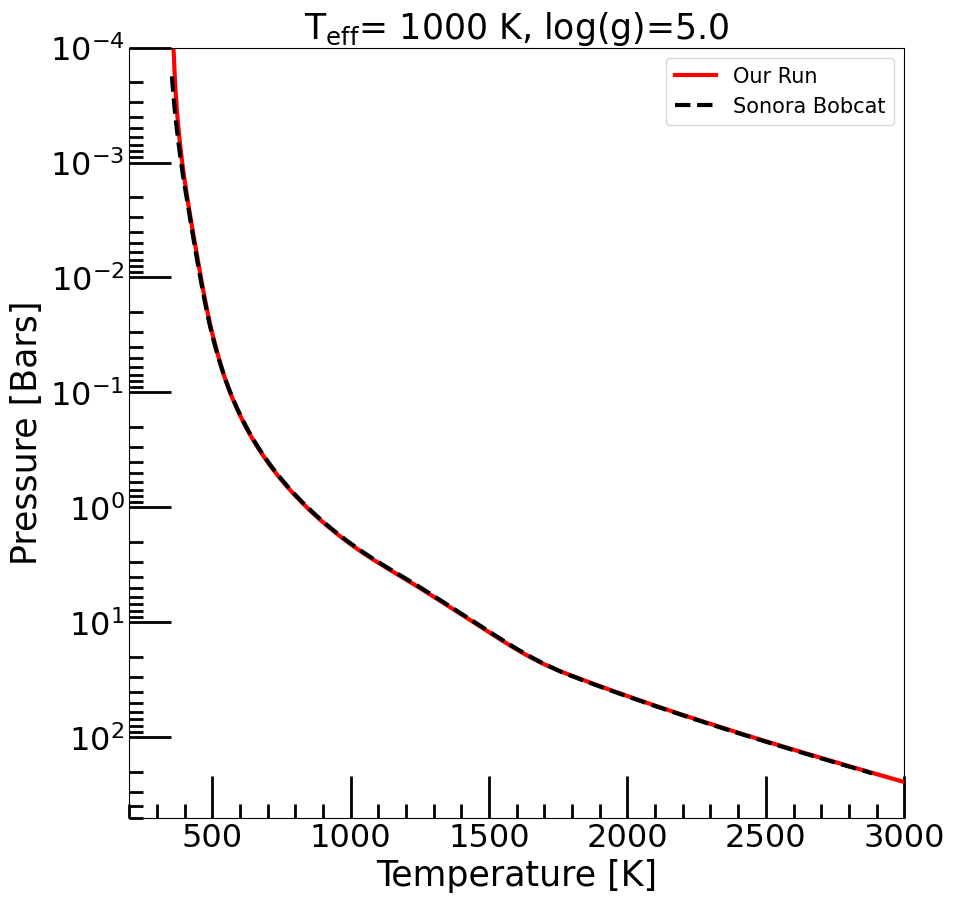

In [11]:
pressure_bobcat,temp_bobcat = np.loadtxt(jdi.os.path.join(
                            sonora_profile_db,f"t{teff}g{grav}nc_m0.0.dat"),
                            usecols=[1,2],unpack=True, skiprows = 1)

plt.figure(figsize=(10,10))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.ylim(500,1e-4)
plt.xlim(200,3000)

plt.semilogy(out['temperature'],out['pressure'],color="r",linewidth=3,label="Our Run")

plt.semilogy(temp_bobcat,pressure_bobcat,color="k",linestyle="--",linewidth=3,label="Sonora Bobcat")


plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

plt.title(r"T$_{\rm eff}$= 1000 K, log(g)=5.0",fontsize=25)



## Climate Plots and Animations 

### Animate Convergence

We can also try to see how our initial guess of an isothermal atmosphere was changed by the code to reach the converged solution

In [12]:
ani = jpi.animate_convergence(out, cl_run, opacity_ck, 
    molecules=['H2O','CH4','CO','NH3'])

In [13]:
ani

### Brightness Temperature

Checking the brightness temperature serves many useful purposes: 

1. Intuition building. Allows you to see what corresponding temperature are you sensitive to at each wavelength 

Note that this temperature doesn't need to be the physical temperature of your atmosphere but if you can find the physical converged atmospheric temperature closest to this brightness temperature you can also get an idea of the atmospheric pressure from where the flux you are seeing is originating from.

2. Determining if your choice in bottom boundary pressure grid was correct. 

If your brightness temperature is such that you bottom out at the temperature corresponding to the highest pressure, you have not extended your grid to high enough pressures. 

Brightness Temperature Equation:

$T_{\rm bright}=\dfrac{a}{{\lambda}log\left(\dfrac{{b}}{F(\lambda){\lambda}^5}+1\right)}$

where a = 1.43877735x$10^{-2}$ m.K and b = 11.91042952x$10^{-17}$ m$^4$kg/s$^3$ 

Let's calculate the brightness temperature of our current run and check if our pressure grid was okay.

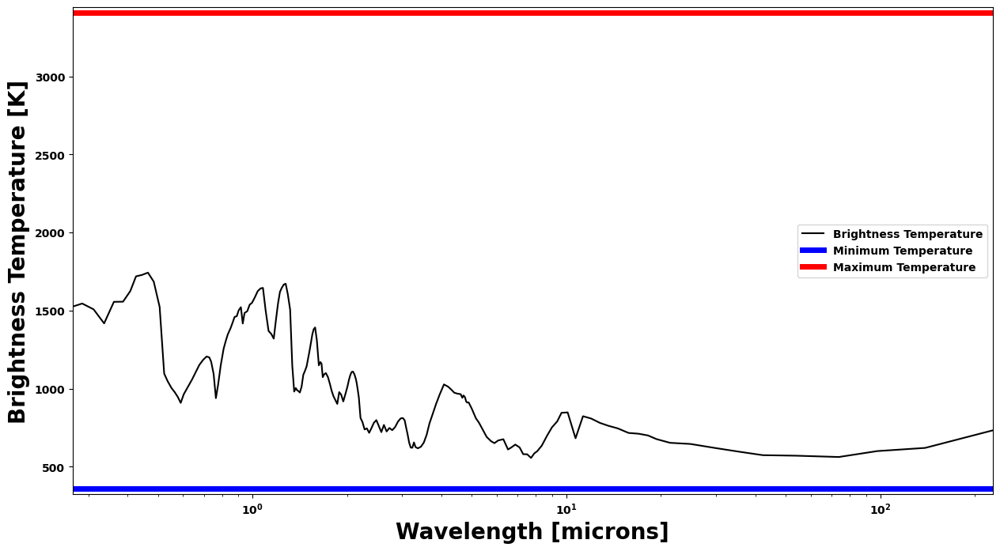

In [14]:
brightness_temp, figure= jpi.brightness_temperature(out['spectrum_output'])

In the above plot you can see that your brightness temperature is nicely bound between the minimum and maximum temperature. Your run is good and your choice of pressure grid is also great. Well done team!


## Selecting an Adequate Pressure Grid

For understanding and intuition building, let's do out a run where we purposely choose an incomplete pressure grid. Let's do the same run by the max pressure set at only 3 bars instead of 500 bars.

In [15]:
cl_bad_pres = jdi.inputs(calculation="brown", climate = True)
cl_bad_pres.gravity(gravity=grav, gravity_unit=u.Unit('m/(s**2)')) # input gravity
cl_bad_pres.effective_temp(teff)

nlevel = 91 # number of plane-parallel levels in your code
Pmin = 1e-4 #bars
Pmax = 3 #bars
pressure=np.logspace(np.log10(Pmin),np.log10(Pmax),nlevel) # set your pressure grid

temp_guess = np.zeros(shape=(nlevel)) + 500 # K , isothermal atmosphere guess

nofczns = 1 # number of convective zones initially. Let's not play with this for now.

nstr_upper = 83 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones

rfacv = 0.0 #we are focused on a brown dwarf so let's keep this as is

cl_bad_pres.inputs_climate(temp_guess= temp_guess, pressure= pressure, 
                      nstr = nstr, nofczns = nofczns , rfacv = rfacv)
out_bad_pres = cl_bad_pres.climate(opacity_ck, save_all_profiles=True,with_spec=True)

Iteration number  0 , min , max temp  499.00074464230147 659.9082314351286 , flux balance  -0.8868736488989312
Iteration number  1 , min , max temp  491.3943903834831 827.818936580699 , flux balance  -0.756805334244827


Iteration number  2 , min , max temp  484.3893149315085 890.4016296530503 , flux balance  -0.6695079923312093
Iteration number  3 , min , max temp  477.6387044933263 929.874035315147 , flux balance  -0.596437178305279
Iteration number  4 , min , max temp  460.0385388404085 1005.3583036664587 , flux balance  -0.3986119791647743
Iteration number  5 , min , max temp  401.6117631649563 1122.4623577501077 , flux balance  0.1781093192321377
Iteration number  6 , min , max temp  381.04423637971433 1098.3420771197498 , flux balance  0.01977187579232981
Iteration number  7 , min , max temp  378.0003147023735 1095.20159866866 , flux balance  0.0009352217381712142
Iteration number  8 , min , max temp  377.8831641492345 1095.0486709104855 , flux balance  3.562133580365806e-05
In t_start: Converged Solution in iterations  8
Big iteration is  377.8831641492345 0


Iteration number  0 , min , max temp  373.47581438160887 1117.180136980086 , flux balance  -0.145116042374335
Iteration number  1 , min , max temp  365.7107978476365 1147.481689009624 , flux balance  0.006688735802526288
Iteration number  2 , min , max temp  365.22086002053067 1146.2922340283378 , flux balance  0.000264277580673826
In t_start: Converged Solution in iterations  2
Big iteration is  365.22086002053067 1


Iteration number  0 , min , max temp  364.47676783513464 1151.8253757850377 , flux balance  -0.0006654182569242374
In t_start: Converged Solution in iterations  0
Profile converged before itmx


Iteration number  0 , min , max temp  364.49399619993284 1152.2630444825734 , flux balance  -8.518890725643545e-05
In t_start: Converged Solution in iterations  0
Big iteration is  364.49399619993284 0


Iteration number  0 , min , max temp  364.51047899528396 1152.3014333505616 , flux balance  -7.706430923429419e-06
In t_start: Converged Solution in iterations  0
Profile converged before itmx
final [ 0 83 89  0  0  0]


 We are already at a root, tolf , test =  5e-05 ,  2.2628345358141883e-05
Big iteration is  364.51047899528396 0
 We are already at a root, tolf , test =  5e-05 ,  2.2628345358141883e-05


Profile converged before itmx
YAY ! ENDING WITH CONVERGENCE


Lets plot the profile from our new run and check it against our old run.

Text(0.5, 1.0, 'T$_{\\rm eff}$= 1000 K, log(g)=5.0')

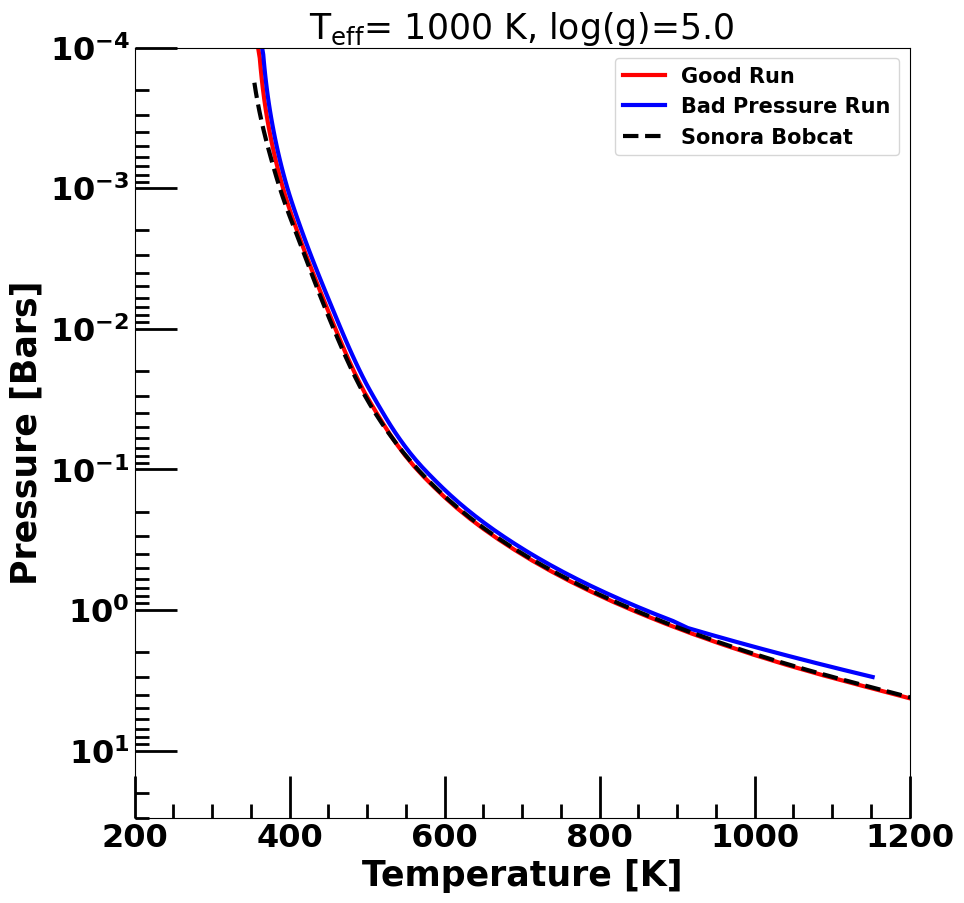

In [16]:
plt.figure(figsize=(10,10))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.ylim(30,1e-4)
plt.xlim(200,1200)

plt.semilogy(out['temperature'],out['pressure'],color="r",linewidth=3,label="Good Run")
plt.semilogy(out_bad_pres['temperature'],out_bad_pres['pressure'],color="b",linewidth=3,label="Bad Pressure Run")

plt.semilogy(temp_bobcat,pressure_bobcat,color="k",linestyle="--",linewidth=3,label="Sonora Bobcat")


plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

plt.title(r"T$_{\rm eff}$= 1000 K, log(g)=5.0",fontsize=25)



This new profile is slightly off from our run and also the sonora bobcat run. Lets look at its brightness temperature as a function of wavelength and check if it matches well with our previous run.

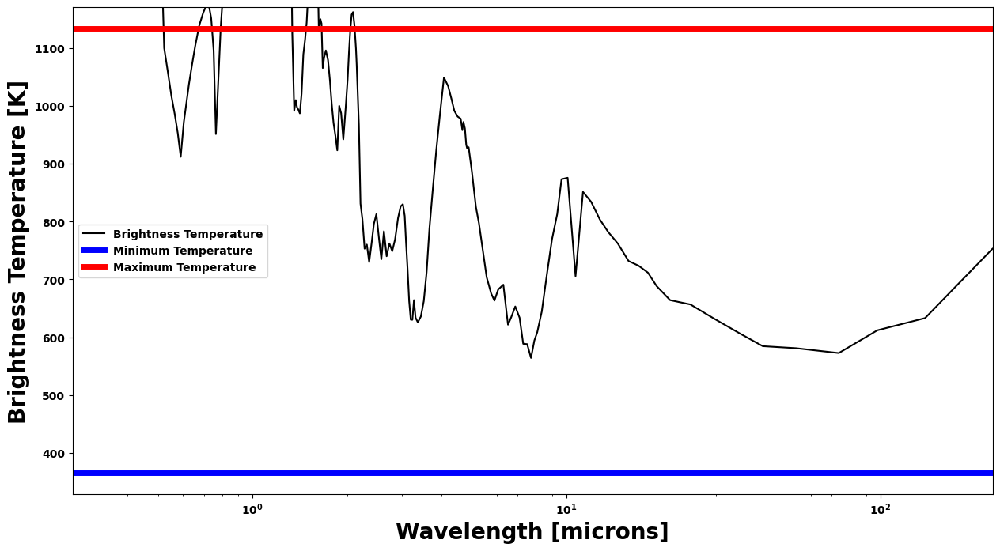

In [17]:
brightness_temp_bad, figure_bad= jpi.brightness_temperature(
    out_bad_pres['spectrum_output'])

See how the brightness temperature from this new run is different from our previous succesful run. The brightness temperatures infact goes over the maximum temperature achieved by the model. Therefore the pressure grid used for this run is incorrect because one can look through the atmosphere to the bottom of the grid at most wavelengths which is not good and the resultant "converged" T(P) profile is also visibly inaccurate as a result as well.

## Post Process High Resolution Spectrum
We can quickly do this by resetting the opannection to not use the ck database and use the `ptchem_df` DataFrame as input for the atmosphere 

This is also the point where you could post-process clouds using `virga` or a `box model` as seen in these tutorials here: 
1. [Adding clouds with virga](https://natashabatalha.github.io/picaso/notebooks/7_PairingPICASOToVIRGA.html) 
2. [Adding box model clouds](https://natashabatalha.github.io/picaso/notebooks/5_AddingTransitSpectrum.html#Adding-Grey-Cloud) 

In [18]:
opa_mon = jdi.opannection()

hi_res = jdi.inputs(calculation="browndwarf") # start a calculation 
teff= 1000 # Effective Temperature of your Brown Dwarf in K
grav = 1000 # Gravity of your brown dwarf in m/s/s

hi_res.gravity(gravity=grav, gravity_unit=u.Unit('m/(s**2)')) # input gravity

hi_res.atmosphere(df=out['ptchem_df']) 
df_spec = hi_res.spectrum(opa_mon, calculation='thermal', full_output=True)
w,f = jdi.mean_regrid(df_spec['wavenumber'],df_spec['thermal'], R=100)

In [19]:
jpi.show(jpi.spectrum(w,f,x_axis_type='log',y_axis_type='log'))

## `xarray` model storage with post-processed models 

In [20]:
preserve_hires = jdi.output_xarray(df_spec, hi_res)

In [21]:
preserve_hires

<xarray.Dataset> Size: 489kB
Dimensions:        (pressure: 91, wavelength: 28717)
Coordinates:
  * pressure       (pressure) float64 728B 0.0001 0.0001187 ... 421.2 500.0
  * wavelength     (wavelength) float64 230kB 5.3 5.299 5.299 ... 0.3001 0.3
Data variables: (12/40)
    temperature    (pressure) float64 728B 359.3 361.5 ... 3.35e+03 3.463e+03
    flux_emission  (wavelength) float64 230kB 4.176e+10 3.468e+10 ... 2.353e+03
    e-             (pressure) float64 728B 4.5e-38 4.5e-38 ... 2.532e-07
    H2             (pressure) float64 728B 0.8362 0.8362 0.8362 ... 0.819 0.8153
    H              (pressure) float64 728B 7.189e-28 1.026e-27 ... 0.02197
    H+             (pressure) float64 728B 4.5e-38 4.5e-38 ... 6.658e-16
    ...             ...
    OCS            (pressure) float64 728B 1.013e-22 1.074e-22 ... 4.346e-10
    Li             (pressure) float64 728B 4.5e-38 4.5e-38 ... 2.194e-09
    LiOH           (pressure) float64 728B 4.5e-38 4.5e-38 ... 5.348e-11
    LiH            (pressure) float64 728B 4.5e-38 4.5e-38 ... 1.204e-09
    LiCl           (pressure) float64 728B 4.5e-38 4.5e-38 ... 4.816e-13
    LiF            (pressure) float64 728B 4.5e-38 4.5e-38 ... 2.427e-14
Attributes:
    planet_params:  {"effective_temp": 959.3412407197163, "gravity": {"value"...